In [ ]:
!nvidia-smi

Thu Dec  2 06:37:57 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   32C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Load data


In [ ]:
import torch.nn as nn
import cv2
import glob2
import math  
import os
import numpy as np
import pandas as pd
from shutil import copy
import seaborn as sns
import matplotlib.pyplot as plt
import math
import torch
from torch.utils.data import DataLoader
from torchvision.utils import save_image as imwrite
import time
import re
from PIL import Image
from torch.utils.data import Dataset
from torchvision import transforms
from torchsummary import summary
import torchvision.transforms.functional as TF
import random
import pywt
import torchvision
import copy
import torch.optim as optim
from datetime import datetime
import pytz
import torch.nn.functional as F
from tensorboardX import SummaryWriter
from math import log10
from torch.nn.modules import loss
import torchsummary
import logging 
!pip install tensorboardX
join = os.path.join
device_ids = [Id for Id in range(torch.cuda.device_count())]
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

#Preprocessing DATA

In [ ]:
def get_data(data_dir):
  data = []
  for img in os.listdir(data_dir):
      try:
          img_arr = cv2.imread(os.path.join(data_dir, img))#[...,::-1]
          data.append([img_arr, img_arr.shape[0], img_arr.shape[1]])
      except:
          pass
  return np.array(data)
s = get_data('/content/DATA/Test/SOTS/indoor/gt')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  if __name__ == '__main__':


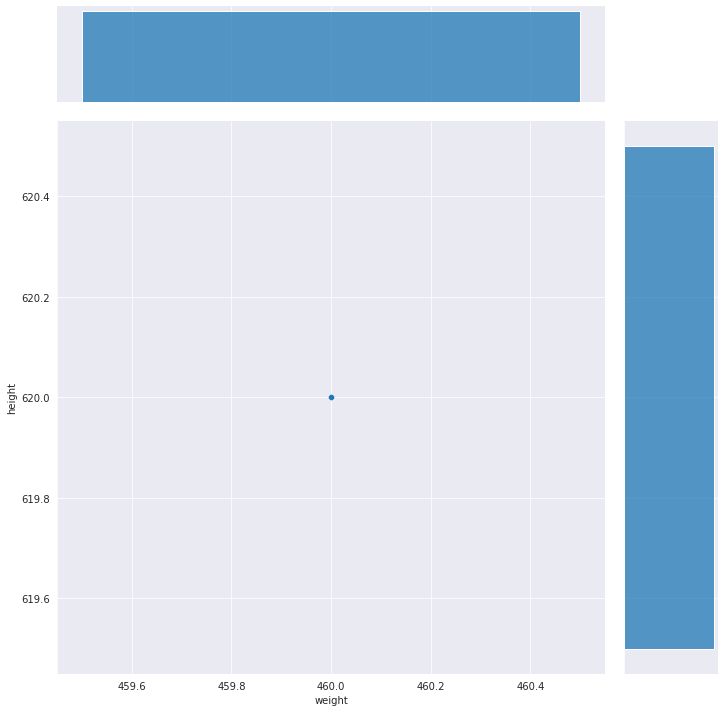

In [ ]:
df = pd.DataFrame(data = s,columns=['image','weight','height'])
sns.set_style('darkgrid')
sns.jointplot(data=df, x="weight", y="height",height=10)

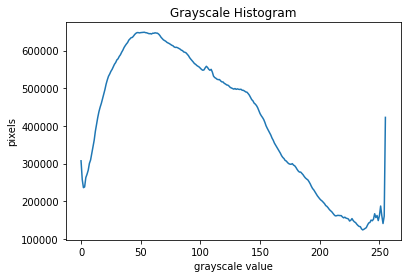

mean:  102.78989410198331
std:  62.42475961800457


In [ ]:
# %cd '/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020'

a = np.zeros(shape=(1,1600))

for i in range(55):
  if i<9:
    img = cv2.imread('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/0'+str(i+1)+'_GT.png')
    # print('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/0'+str(i+1)+'_GT.png')
  else:
    img = cv2.imread('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/'+str(i+1)+'_GT.png')
    # print('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/'+str(i+1)+'_GT.png')
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  a = np.concatenate((img_gray,a))
np.delete(a,a.shape[0]-1,0)
histogram, bin_edges = np.histogram(a, bins=256, range=(0, 256))

plt.figure()
plt.title("Grayscale Histogram")
plt.xlabel("grayscale value")
plt.ylabel("pixels")

plt.plot(bin_edges[0:-1], histogram)  # <- or here
plt.show()
print('mean: ', a.mean())
print('std: ', a.std())

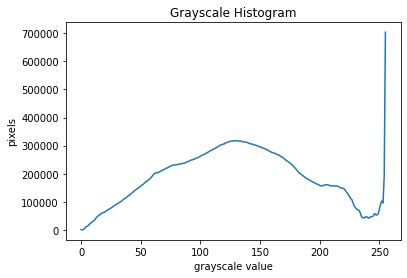

mean:  131.9360535690477
std:  57.44219726527351


In [ ]:
a1 = np.zeros((1,1600))
source = '/content/drive/MyDrive/DW  GAN/data/NTIRE2021/Tr_hazeFree'
for i in os.listdir(source):
  img = cv2.imread(join(source,i))
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  a1 = np.concatenate((img_gray,a1))

np.delete(a1,a1.shape[0]-1,0)
histogram, bin_edges = np.histogram(a1, bins=256, range=(0, 256))

plt.figure()
plt.title("Grayscale Histogram")
plt.xlabel("grayscale value")
plt.ylabel("pixels")

plt.plot(bin_edges[0:-1], histogram)  # <- or here
plt.show()
print('mean: ', a1.mean())
print('std: ', a1.std())

In [ ]:
gamma= 0.65
for i in range(55):
  if i<9:
    path = '/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/0'+str(i+1)+'_GT.png'
  else:
    path = '/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/'+str(i+1)+'_GT.png'
  img = cv2.imread(path)
  img = 255. * 1  * np.power(img / 255., gamma)
  cv2.imwrite(path, img)

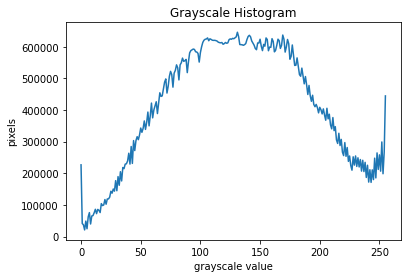

mean:  134.27845007083226
std:  57.76024537860451


In [ ]:
a = np.zeros(shape=(1,1600))

for i in range(55):
  if i<9:
    img = cv2.imread('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/0'+str(i+1)+'_GT.png')
    # print('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/0'+str(i+1)+'_GT.png')
  else:
    img = cv2.imread('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/'+str(i+1)+'_GT.png')
    # print('/content/drive/MyDrive/DW  GAN/data/NTIRE2020/NTIRE2020/'+str(i+1)+'_GT.png')
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  a = np.concatenate((img_gray,a))
np.delete(a,a.shape[0]-1,0)
histogram, bin_edges = np.histogram(a, bins=256, range=(0, 256))

plt.figure()
plt.title("Grayscale Histogram")
plt.xlabel("grayscale value")
plt.ylabel("pixels")

plt.plot(bin_edges[0:-1], histogram)  # <- or here
plt.show()
print('mean: ', a.mean())
print('std: ', a.std())

In [ ]:
w_l = pywt.wavelist(kind='discrete')
len(w_l)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

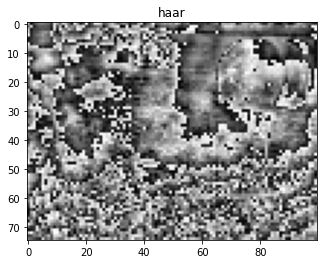

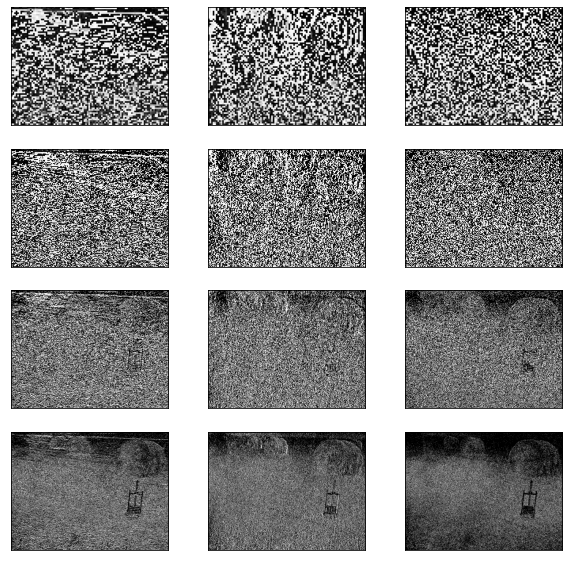

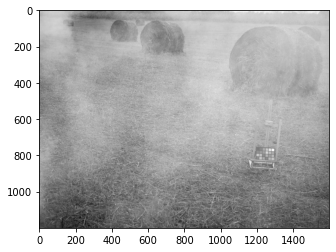

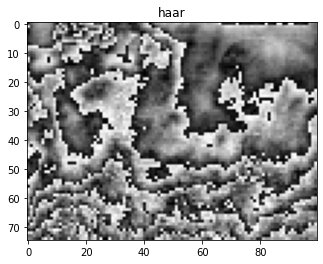

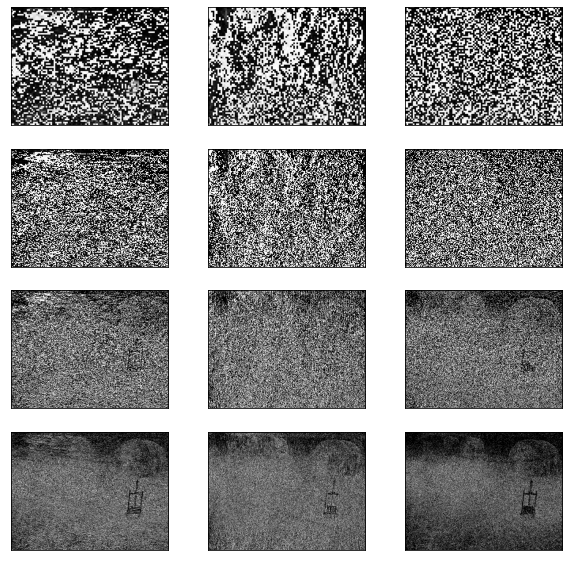

...

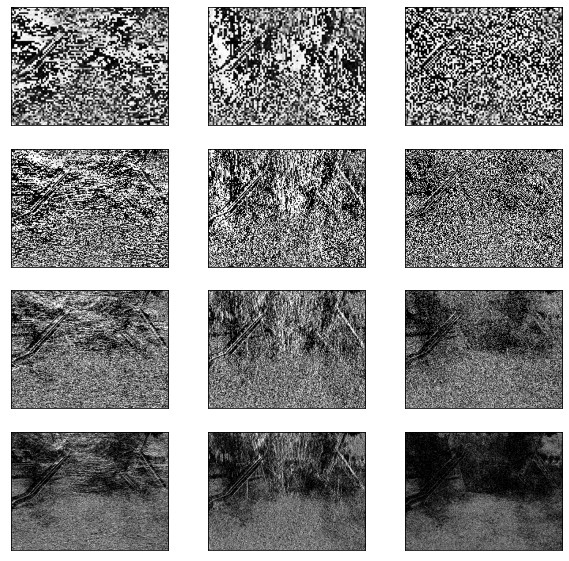

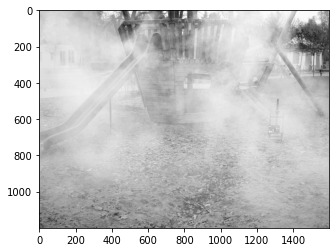

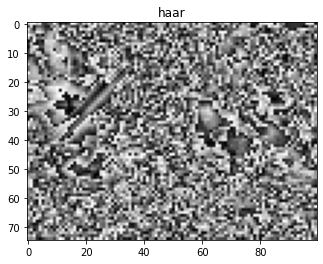

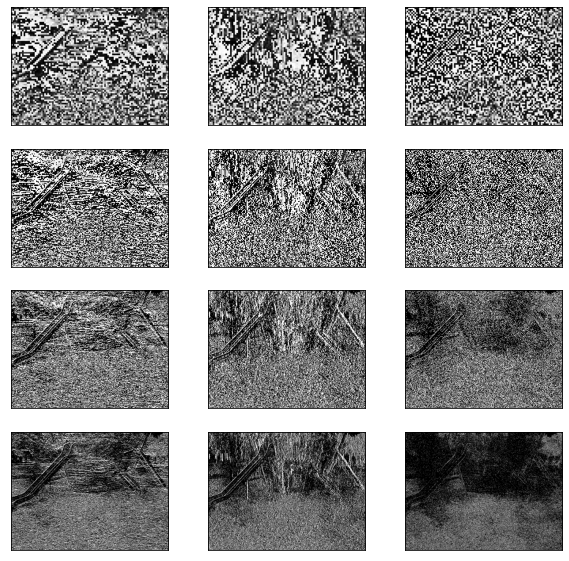

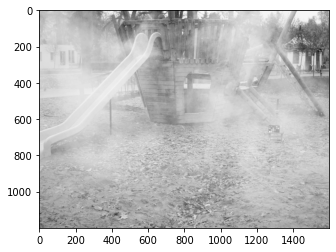

In [ ]:
source = '/content/drive/MyDrive/DW  GAN/data/Test'
file_name = os.listdir(source)
for name in file_name:
  for i1 in [-1,0,1,2]:
    A = cv2.imread(join(source,name))
    if i1 == -1:
      B = np.mean(A, i1)
    else:
      B= A[:,:,i1]
    w_l = pywt.wavelist(kind='discrete')
    n = 4
    w = 'haar'
    coeffs_img = pywt.wavedec2(B,wavelet=w,level=n)
    path_save = join('/content/drive/MyDrive/DW  GAN/D-H',name)
    if not os.path.exists(path_save):
      os.makedirs(path_save)

    fig1, axs1 = plt.subplots(1,1)
    plt.title(w)
    a = coeffs_img[0]
    axs1.imshow(a.astype('uint8'),cmap='gray')
    fig1.savefig(join(path_save,'dd_('+str(i1)+').png'))
    fig, axs = plt.subplots(nrows=4, ncols=3, figsize=(10, 10),
                            subplot_kw={'xticks': [], 'yticks': []})

    axs = axs.flat
    inde = [0,3,6,9]
    for i, index in zip(range(n),inde):
        v = coeffs_img[i+1]
        axs[index].imshow(v[0].astype('uint8'),cmap='gray')  
        axs[index + 1].imshow(v[1].astype('uint8'),cmap='gray')
        axs[index + 2].imshow(v[2].astype('uint8'),cmap='gray')
      
    fig.savefig(join(path_save,'hh-dh-hd_('+str(i1)+').png'))   
    Arecon = pywt.waverec2(coeffs_img,wavelet=w) 
    plt.figure()
    plt.imshow(Arecon.astype('uint8'),cmap='gray')
    plt.savefig(join(path_save,'rec.png'))

#model

In [ ]:
class Res2Net(nn.Module):
    def __init__(self, block, layers, baseWidth=26, scale=4, num_classes=1000):
        self.inplanes = 64
        super(Res2Net, self).__init__()
        self.baseWidth = baseWidth
        self.scale = scale
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 32, 3, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, 3, 1, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        )
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2) 
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Linear(512 * block.expansion, num_classes) 
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.AvgPool2d(kernel_size=stride, stride=stride,
                             ceil_mode=True, count_include_pad=False),
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=1, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample=downsample,
                            stype='stage', baseWidth=self.baseWidth, scale=self.scale))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes, baseWidth=self.baseWidth, scale=self.scale))

        return nn.Sequential(*layers)

    def forward(self, x):
        print(f'input={x.size()}')
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        print(f'after maxpool: {x.size()}')

        x = self.layer1(x)
        print(f'after layer1: {x.size}')
        x = self.layer2(x)
        print(f'after layer2: {x.size}')
        x = self.layer3(x)
        print(f'after layer3: {x.size}')
        x = self.layer4(x)
        print(f'after layer4: {x.size}')

        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        print(f'x: {x.size}')
        x = self.fc(x)

        print(f'after fc output: {x.size}')

        return x
def default_conv(in_channels, out_channels, kernel_size, bias=True):
    return nn.Conv2d(in_channels, out_channels, kernel_size, padding=(kernel_size // 2), bias=bias)

def dwt_init(x):
    x01 = x[:, :, 0::2, :] / 2
    x02 = x[:, :, 1::2, :] / 2
    x1 = x01[:, :, :, 0::2]
    x2 = x02[:, :, :, 0::2]
    x3 = x01[:, :, :, 1::2]
    x4 = x02[:, :, :, 1::2]
    x_LL = x1 + x2 + x3 + x4
    x_HL = -x1 - x2 + x3 + x4
    x_LH = -x1 + x2 - x3 + x4
    x_HH = x1 - x2 - x3 + x4
    return x_LL, torch.cat((x_HL, x_LH, x_HH), 1)

class DWT(nn.Module):
    def __init__(self):
        super(DWT, self).__init__()
        self.requires_grad = False
    def forward(self, x):
        return dwt_init(x)

class PALayer(nn.Module):
    def __init__(self, channel):
        super(PALayer, self).__init__()
        self.pa = nn.Sequential(
            nn.Conv2d(channel, channel // 8, 1, padding=0, bias=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(channel // 8, 1, 1, padding=0, bias=True),
            nn.Sigmoid()
        )
    def forward(self, x):
        y = self.pa(x)
        return x * y

class CALayer(nn.Module):
    def __init__(self, channel):
        super(CALayer, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.ca = nn.Sequential(
            nn.Conv2d(channel, channel // 8, 1, padding=0, bias=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(channel // 8, channel, 1, padding=0, bias=True),
            nn.Sigmoid()
        )
    def forward(self, x):
        y = self.avg_pool(x)
        y = self.ca(y)
        return x * y

class Bottle2neck(nn.Module):
    expansion = 4
    def __init__(self, inplanes, planes, stride=1, downsample=None, baseWidth=26, scale=4, stype='normal'):
        super(Bottle2neck, self).__init__()
        width = int(math.floor(planes * (baseWidth / 64.0)))
        self.conv1 = nn.Conv2d(inplanes, width * scale, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(width * scale)
        if scale == 1:
            self.nums = 1
        else:
            self.nums = scale - 1
        if stype == 'stage':
            self.pool = nn.AvgPool2d(kernel_size=3, stride=stride, padding=1)
        convs = []
        bns = []
        for i in range(self.nums):
            convs.append(nn.Conv2d(width, width, kernel_size=3, stride=stride, padding=1, bias=False))
            bns.append(nn.BatchNorm2d(width))
        self.convs = nn.ModuleList(convs)
        self.bns = nn.ModuleList(bns)
        self.conv3 = nn.Conv2d(width * scale, planes * self.expansion, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * self.expansion)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample
        self.stype = stype
        self.scale = scale
        self.width = width
    def forward(self, x):
        residual = x
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        spx = torch.split(out, self.width, 1)
        for i in range(self.nums):
            if i == 0 or self.stype == 'stage':
                sp = spx[i]
            else:
                sp = sp + spx[i]
            sp = self.convs[i](sp)
            sp = self.relu(self.bns[i](sp))
            if i == 0:
                out = sp
            else:
                out = torch.cat((out, sp), 1)
        if self.scale != 1 and self.stype == 'normal':
            out = torch.cat((out, spx[self.nums]), 1)
        elif self.scale != 1 and self.stype == 'stage':
            out = torch.cat((out, self.pool(spx[self.nums])), 1)
        out = self.conv3(out)
        out = self.bn3(out)
        if self.downsample is not None:
            residual = self.downsample(x)
        out += residual
        out = self.relu(out)
        return out

u = Res2Net(Bottle2neck, [3, 4, 23, 3], baseWidth=26, scale=4)
class Res2Net(nn.Module):
    def __init__(self, block, layers, baseWidth=26, scale=4, num_classes=1000):
        self.inplanes = 64
        super(Res2Net, self).__init__()
        self.baseWidth = baseWidth
        self.scale = scale
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 32, 3, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, 3, 1, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        )
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.AvgPool2d(kernel_size=stride, stride=stride,
                             ceil_mode=True, count_include_pad=False),
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=1, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )
        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample=downsample,
                            stype='stage', baseWidth=self.baseWidth, scale=self.scale))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes, baseWidth=self.baseWidth, scale=self.scale))
        return nn.Sequential(*layers)
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x_init = self.relu(x)
        x = self.maxpool(x_init)
        x_layer1 = self.layer1(x)
        x_layer2 = self.layer2(x_layer1)
        x_output= self.layer3(x_layer2)
        return x_init, x_layer1, x_layer2, x_output

class CP_Attention_block(nn.Module):
    def __init__(self, conv, dim, kernel_size):
        super(CP_Attention_block, self).__init__()
        self.conv1 = conv(dim, dim, kernel_size, bias=True)
        self.act1 = nn.ReLU(inplace=True)
        self.conv2 = conv(dim, dim, kernel_size, bias=True)
        self.calayer = CALayer(dim)
        self.palayer = PALayer(dim)
    def forward(self, x):
        res = self.act1(self.conv1(x))
        res = res + x
        res = self.conv2(res)
        res = self.calayer(res)
        res = self.palayer(res)
        res += x
        return res

class knowledge_adaptation_UNet(nn.Module):
    def __init__(self):
        super(knowledge_adaptation_UNet, self).__init__()
        self.encoder = Res2Net(Bottle2neck, [3, 4, 23, 3], baseWidth=26, scale=4)
        res2net101 = u
        res2net101.load_state_dict(torch.load('/content/drive/MyDrive/DW  GAN/res2net101_v1b_26w_4s-0812c246.pth'))
        pretrained_dict = res2net101.state_dict()
        model_dict = self.encoder.state_dict()
        key_dict = {k: v for k, v in pretrained_dict.items() if k in model_dict}
        model_dict.update(key_dict)
        self.encoder.load_state_dict(model_dict)
        self.up_block= nn.PixelShuffle(2)
        self.attention0 = CP_Attention_block(default_conv, 1024, 3)
        self.attention1 = CP_Attention_block(default_conv, 256, 3)
        self.attention2 = CP_Attention_block(default_conv, 192, 3)
        self.attention3 = CP_Attention_block(default_conv, 112, 3)
        self.attention4 = CP_Attention_block(default_conv, 44, 3)
        self.conv_process_1 = nn.Conv2d(44, 44, kernel_size=3,padding=1)
        self.conv_process_2 = nn.Conv2d(44, 28, kernel_size=3,padding=1)
        self.tail = nn.Sequential(nn.ReflectionPad2d(3), nn.Conv2d(28, 3, kernel_size=7, padding=0), nn.Tanh())
    def forward(self, input):
        x_inital, x_layer1, x_layer2, x_output = self.encoder(input)
        x_mid = self.attention0(x_output)
        x = self.up_block(x_mid)
        x = self.attention1(x)
        x = torch.cat((x, x_layer2), 1)
        x = self.up_block(x)
        x = self.attention2(x)
        x = torch.cat((x, x_layer1), 1)
        x = self.up_block(x)
        x = self.attention3(x)
        x = torch.cat((x, x_inital), 1)
        x = self.up_block(x)
        x = self.attention4(x)
        x=self.conv_process_1(x)
        out=self.conv_process_2(x)
        return out

class DWT_transform(nn.Module):
    def __init__(self, in_channels,out_channels):
        super().__init__()
        self.dwt = DWT()
        self.conv1x1_low = nn.Conv2d(in_channels, out_channels, kernel_size=1, padding=0)
        self.conv1x1_high = nn.Conv2d(in_channels*3, out_channels, kernel_size=1, padding=0)
    def forward(self, x):
        dwt_low_frequency,dwt_high_frequency = self.dwt(x)
        dwt_low_frequency = self.conv1x1_low(dwt_low_frequency)
        dwt_high_frequency = self.conv1x1_high(dwt_high_frequency)
        return dwt_low_frequency,dwt_high_frequency

def blockUNet(in_c, out_c, name, transposed=False, bn=False, relu=True, dropout=False):
    block = nn.Sequential()
    if relu:
        block.add_module('%s_relu' % name, nn.ReLU(inplace=True))
    else:
        block.add_module('%s_leakyrelu' % name, nn.LeakyReLU(0.2, inplace=True))
    if not transposed:
        block.add_module('%s_conv' % name, nn.Conv2d(in_c, out_c, 4, 2, 1, bias=False))
    else:
        block.add_module('%s_tconv' % name, nn.ConvTranspose2d(in_c, out_c, 4, 2, 1, bias=False))
    if bn:
        block.add_module('%s_bn' % name, nn.BatchNorm2d(out_c))
    if dropout:
        block.add_module('%s_dropout' % name, nn.Dropout2d(0.5, inplace=True))
    return block

class dwt_UNet(nn.Module):
    def __init__(self,output_nc=3, nf=16):
        super(dwt_UNet, self).__init__()
        layer_idx = 1
        name = 'layer%d' % layer_idx
        layer1 = nn.Sequential()
        layer1.add_module(name, nn.Conv2d(16, nf-1, 4, 2, 1, bias=False))
        layer_idx += 1
        name = 'layer%d' % layer_idx
        layer2 = blockUNet(nf, nf*2-2, name, transposed=False, bn=True, relu=False, dropout=False)
        layer_idx += 1
        name = 'layer%d' % layer_idx
        layer3 = blockUNet(nf*2, nf*4-4, name, transposed=False, bn=True, relu=False, dropout=False)
        layer_idx += 1
        name = 'layer%d' % layer_idx
        layer4 = blockUNet(nf*4, nf*8-8, name, transposed=False, bn=True, relu=False, dropout=False)
        layer_idx += 1
        name = 'layer%d' % layer_idx
        layer5 = blockUNet(nf*8, nf*8-16, name, transposed=False, bn=True, relu=False, dropout=False)
        layer_idx += 1
        name = 'layer%d' % layer_idx
        layer6 = blockUNet(nf*8, nf*8, name, transposed=False, bn=False, relu=False, dropout=False)

        layer_idx -= 1
        name = 'dlayer%d' % layer_idx
        dlayer6 = blockUNet(nf * 8, nf * 8, name, transposed=True, bn=True, relu=True, dropout=False)
        layer_idx -= 1
        name = 'dlayer%d' % layer_idx
        dlayer5 = blockUNet(nf * 16+16, nf * 8, name, transposed=True, bn=True, relu=True, dropout=False)
        layer_idx -= 1
        name = 'dlayer%d' % layer_idx
        dlayer4 = blockUNet(nf * 16+8, nf * 4, name, transposed=True, bn=True, relu=True, dropout=False)
        layer_idx -= 1
        name = 'dlayer%d' % layer_idx
        dlayer3 = blockUNet(nf * 8+4, nf * 2, name, transposed=True, bn=True, relu=True, dropout=False)
        layer_idx -= 1
        name = 'dlayer%d' % layer_idx
        dlayer2 = blockUNet(nf * 4+2, nf, name, transposed=True, bn=True, relu=True, dropout=False)
        layer_idx -= 1
        name = 'dlayer%d' % layer_idx
        dlayer1 = blockUNet(nf * 2+1, nf * 2, name, transposed=True, bn=True, relu=True, dropout=False)

        self.initial_conv=nn.Conv2d(3,16,3,padding=1)
        self.bn1=nn.BatchNorm2d(16)
        self.layer1 = layer1
        self.DWT_down_0= DWT_transform(3,1)
        self.layer2 = layer2
        self.DWT_down_1 = DWT_transform(16, 2)
        self.layer3 = layer3
        self.DWT_down_2 = DWT_transform(32, 4)
        self.layer4 = layer4
        self.DWT_down_3 = DWT_transform(64, 8)
        self.layer5 = layer5
        self.DWT_down_4 = DWT_transform(128, 16)
        self.layer6 = layer6
        self.dlayer6 = dlayer6
        self.dlayer5 = dlayer5
        self.dlayer4 = dlayer4
        self.dlayer3 = dlayer3
        self.dlayer2 = dlayer2
        self.dlayer1 = dlayer1
        self.tail_conv1 = nn.Conv2d(48, 32, 3, padding=1, bias=True)
        self.bn2=nn.BatchNorm2d(32)
        self.tail_conv2 = nn.Conv2d(nf*2, output_nc, 3,padding=1, bias=True)

    def forward(self, x):
        conv_start=self.initial_conv(x)
        conv_start=self.bn1(conv_start)
        conv_out1 = self.layer1(conv_start)
        dwt_low_0,dwt_high_0=self.DWT_down_0(x)
        out1=torch.cat([conv_out1, dwt_low_0], 1)
        conv_out2 = self.layer2(out1)
        dwt_low_1,dwt_high_1= self.DWT_down_1(out1)
        out2 = torch.cat([conv_out2, dwt_low_1], 1)
        conv_out3 = self.layer3(out2)
        dwt_low_2,dwt_high_2 = self.DWT_down_2(out2)
        out3 = torch.cat([conv_out3, dwt_low_2], 1)
        conv_out4 = self.layer4(out3)
        dwt_low_3,dwt_high_3 = self.DWT_down_3(out3)
        out4 = torch.cat([conv_out4, dwt_low_3], 1)
        conv_out5 = self.layer5(out4)
        dwt_low_4,dwt_high_4 = self.DWT_down_4(out4)
        out5 = torch.cat([conv_out5, dwt_low_4], 1)
        out6 = self.layer6(out5)
        dout6 = self.dlayer6(out6)

        Tout6_out5 = torch.cat([dout6, out5, dwt_high_4], 1)
        Tout5 = self.dlayer5(Tout6_out5)
        Tout5_out4 = torch.cat([Tout5, out4,dwt_high_3], 1)
        Tout4 = self.dlayer4(Tout5_out4)
        Tout4_out3 = torch.cat([Tout4, out3,dwt_high_2], 1)
        Tout3 = self.dlayer3(Tout4_out3)
        Tout3_out2 = torch.cat([Tout3, out2,dwt_high_1], 1)
        Tout2 = self.dlayer2(Tout3_out2)
        Tout2_out1 = torch.cat([Tout2, out1,dwt_high_0], 1)
        Tout1 = self.dlayer1(Tout2_out1)
        Tout1_outinit = torch.cat([Tout1, conv_start], 1)
        tail1=self.tail_conv1(Tout1_outinit)
        tail2=self.bn2(tail1)
        dout1 = self.tail_conv2(tail2)
        return dout1

class fusion_net(nn.Module):
    def __init__(self):
        super(fusion_net, self).__init__()
        self.dwt_branch=dwt_UNet()
        self.knowledge_adaptation_branch=knowledge_adaptation_UNet()
        self.fusion = nn.Sequential(nn.ReflectionPad2d(3), nn.Conv2d(31, 3, kernel_size=7, padding=0), nn.Tanh())
    def forward(self, input):
        dwt_branch=self.dwt_branch(input)
        knowledge_adaptation_branch=self.knowledge_adaptation_branch(input)
        x = torch.cat([dwt_branch, knowledge_adaptation_branch], 1)
        x = self.fusion(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.net = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.LeakyReLU(0.2),

            nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.Conv2d(512, 512, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(512, 1024, kernel_size=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(1024, 1, kernel_size=1)
        )

    def forward(self, x):
        batch_size = x.size(0)
        return torch.sigmoid(self.net(x).view(batch_size))

In [ ]:
net1 = fusion_net().to(device)
# net1 = torch.nn.DataParallel(net1, device_ids=device_ids)
net2 = Discriminator().to(device)
# net2= torch.nn.DataParallel(net2, device_ids=device_ids)

In [ ]:
for param in net1.parameters():
    param.requires_grad = True

for param in net2.parameters():
    param.requires_grad = True

In [ ]:
summary(net1, (3, 576, 448))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 576, 448]             448
       BatchNorm2d-2         [-1, 16, 576, 448]              32
            Conv2d-3         [-1, 15, 288, 224]           3,840
               DWT-4  [[-1, 3, 288, 224], [-1, 9, 288, 224]]               0
            Conv2d-5          [-1, 1, 288, 224]               4
            Conv2d-6          [-1, 1, 288, 224]              10
     DWT_transform-7  [[-1, 1, 288, 224], [-1, 1, 288, 224]]               0
         LeakyReLU-8         [-1, 16, 288, 224]               0
            Conv2d-9         [-1, 30, 144, 112]           7,680
      BatchNorm2d-10         [-1, 30, 144, 112]              60
              DWT-11  [[-1, 16, 144, 112], [-1, 48, 144, 112]]               0
           Conv2d-12          [-1, 2, 144, 112]              34
           Conv2d-13          [-1, 2, 144, 112]              9

In [ ]:
summary(net2,(3,256,256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
         LeakyReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 128, 128]          36,928
       BatchNorm2d-4         [-1, 64, 128, 128]             128
         LeakyReLU-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
       BatchNorm2d-7        [-1, 128, 128, 128]             256
         LeakyReLU-8        [-1, 128, 128, 128]               0
            Conv2d-9          [-1, 128, 64, 64]         147,584
      BatchNorm2d-10          [-1, 128, 64, 64]             256
        LeakyReLU-11          [-1, 128, 64, 64]               0
           Conv2d-12          [-1, 256, 64, 64]         295,168
      BatchNorm2d-13          [-1, 256, 64, 64]             512
        LeakyReLU-14          [-1, 256,

#Data Augument

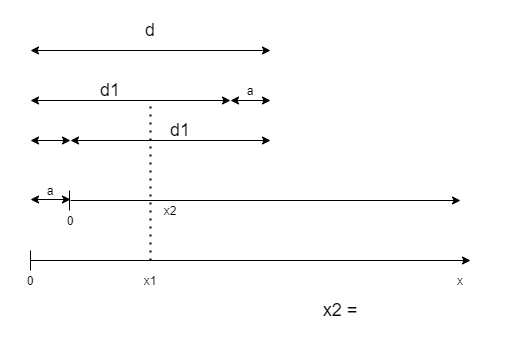

In [ ]:
class DW_GAN_DATASET_VAL(Dataset):
  def __init__(self, ImageFolder):

    # self.list_imageSOTS = []
    # self.list_labelSOTS = []
    
    # for f in os.listdir(join(ImageFolder,'SOTS/indoor/gt/')):
    #   for i in range(10):
    #     self.list_labelSOTS.append(join('SOTS/indoor/gt',f))
    #     self.list_imageSOTS.append(join('SOTS/indoor/hazy',f[:-4]+ '_' + str(i+1)+ '.png'))

    
    # self.list_imageHAZE = []
    # self.list_labelHAZE = [] 

    # for i1 in os.listdir(join(ImageFolder,join('NTIRE','image'))):
    #   self.list_imageHAZE.append(join(join('NTIRE','image'), i1))

    # for i2 in os.listdir(join(ImageFolder,join('NTIRE','label'))):
    #   self.list_labelHAZE.append(join(join('NTIRE','label'), i2))

    # self.list_image = self.list_imageSOTS + self.list_imageHAZE
    # self.list_label = self.list_labelSOTS + self.list_labelHAZE

    self.list_imageHAZE = []
    self.list_labelHAZE = [] 

    for i in os.listdir(join(ImageFolder,'image')):
      self.list_imageHAZE.append(join('image', i))

    for i in os.listdir(join(ImageFolder,'label')):
      self.list_labelHAZE.append(join('label', i))

    self.list_image =  sorted(self.list_imageHAZE) #self.list_imageITS +
    self.list_label =  sorted(self.list_labelHAZE) #self.list_labelITS +




    self.root_image = os.path.join(ImageFolder)
    self.file_len = len(self.list_image)

  def transform(self, hazy, label):
    hazy = TF.to_tensor(hazy)
    label = TF.to_tensor(label)
    return hazy, label

  def __getitem__(self, index, is_train=True):
      hazy = Image.open(join(self.root_image, self.list_image[index]))
      label = Image.open(join(self.root_image, self.list_label[index]))
      
      hazy, label = self.transform(hazy, label)

      hazy_LB = torch.tensor([])
      hazy_RB = torch.tensor([])

      # if 'NTIRE' in self.list_label[index]: 
      hazy_LT = hazy[:,0:1152,:]
      hazy_RT = hazy[:,48:1200,:]
      
      # if 'SOTS' in self.list_label[index]:
      #   hazy_LT = hazy[:, 0:448, 0:576]
      #   hazy_RT = hazy[:, 12:460, 0:576]
      #   hazy_LB = hazy[:, 0:448, 44:620] 
      #   hazy_RB = hazy[:, 12:460, 44:620]
      
      nameI = self.list_image[index]
      nameH = self.list_label[index]
      return hazy_LT, hazy_RT,label,nameI,nameH#hazy_LT, hazy_RT, hazy_LB, hazy_RB, hazy, label, nameI, nameH

  def __len__(self):
      return self.file_len 

In [ ]:
o = Image.open('/content/DATA/Test/SOTS/indoor/gt/1401.png')
o = TF.to_tensor(o).to('cuda')
o_LT = o[:, 0:448, 0:576].unsqueeze(0)
o_RT = o[:, 12:460, 0:576].unsqueeze(0)
o_LB = o[:, 0:448, 44:620].unsqueeze(0)
o_RB = o[:, 12:460, 44:620].unsqueeze(0)

with torch.no_grad():
  a1 = net1(o_LT)
  a2 = net1(o_RT)
  a3 = net1(o_LB)
  a4 = net1(o_RB)

frame_out_T = (torch.cat([o_LT[:, :, 0:230, :].permute(0, 2, 3, 1), o_RT[:, :, 218:, :].permute(0, 2, 3, 1)],1)).permute(0, 3, 1, 2)

frame_out_B = (torch.cat([o_LB[:, :, 0:230, :].permute(0, 2, 3, 1), o_RB[:, :, 218:, :].permute(0, 2, 3, 1)],1)).permute(0, 3, 1, 2)

frame_out = (torch.cat([frame_out_T[:, :, :, 0:310].permute(0, 2, 3, 1), frame_out_B[:, :, :, 266:].permute(0, 2, 3, 1)],2)).permute(0, 3, 1, 2)

imwrite(frame_out, '/content/te.png', range=(0, 1))

/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


In [ ]:
image_datasets = {'train': DW_GAN_DATASET_TRAIN("/content/drive/MyDrive/DW  GAN/data/NTIRE2021/T_V/train"), 'val': DW_GAN_DATASET_VAL("/content/drive/MyDrive/DW  GAN/data/NTIRE2021/T_V/val")}
#data_loader = {x: DataLoader(dataset=image_datasets[x], batch_size=16, shuffle=True, num_workers=0) for x in ['train','val']}
data_loader ={'train': DataLoader(dataset=image_datasets['train'], batch_size=8, shuffle=True, num_workers=0), 'val':DataLoader(dataset=image_datasets['val'], batch_size=1, shuffle=False, num_workers=0)}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}

In [ ]:
%cd '/content/drive/MyDrive/DW  GAN'
!cp '/content/drive/MyDrive/DW  GAN/res2net101_v1b_26w_4s-0812c246.pth' '/content/drive/MyDrive/DW  GAN/data'

/content/drive/MyDrive/DW  GAN


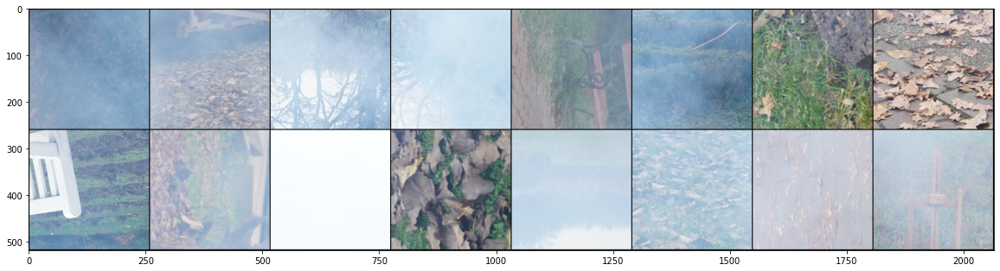

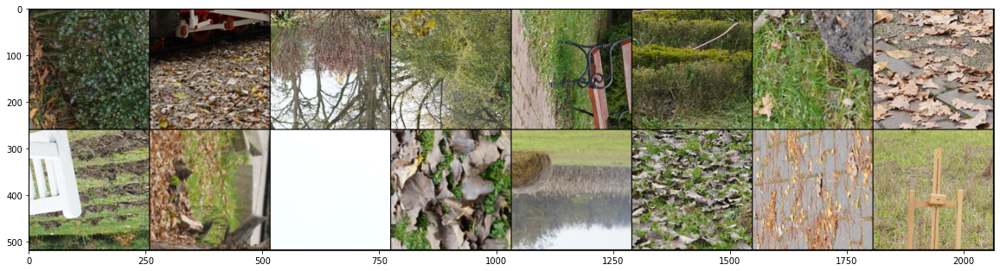

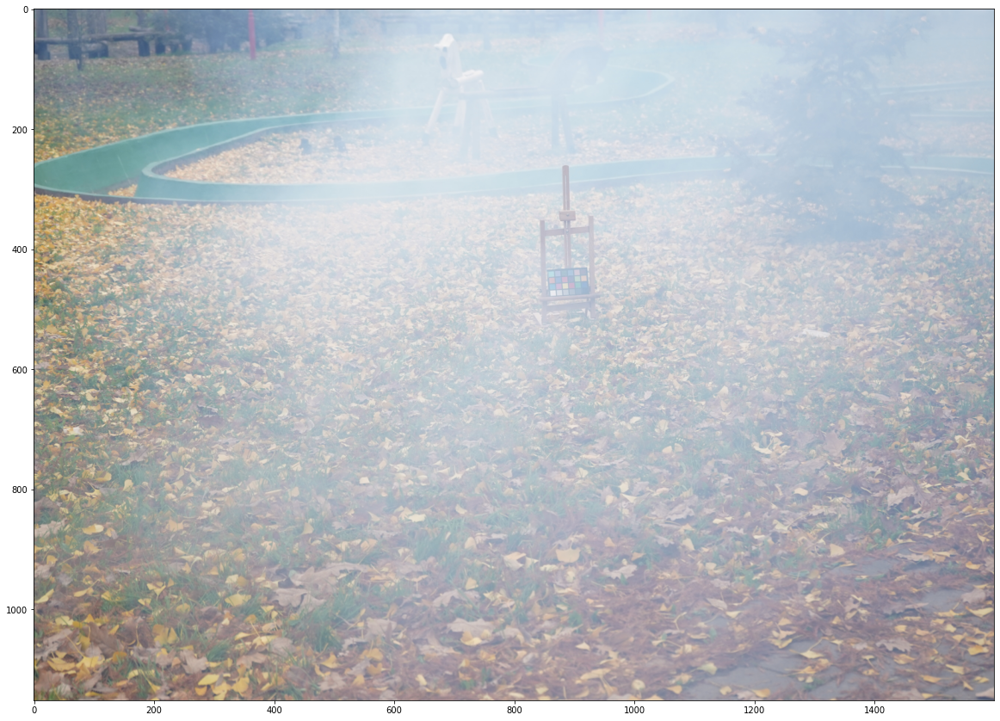

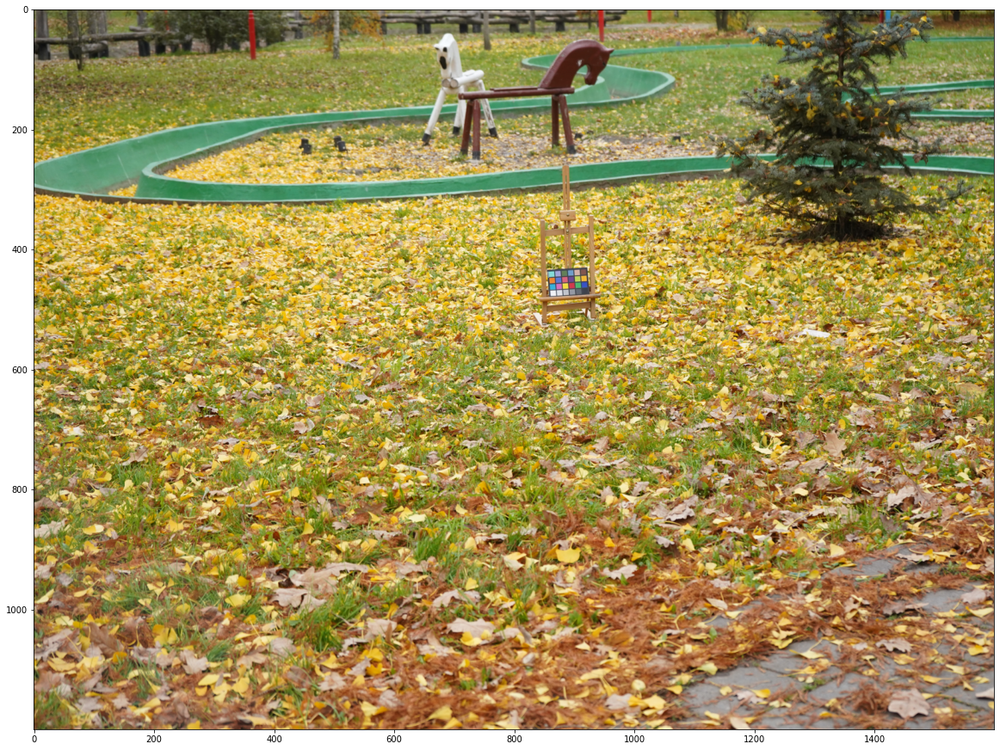

In [ ]:
def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    plt.figure(figsize=(20, 20))
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)

with torch.no_grad():
  inputs_T, label_T, nameI, nameH = next(iter(data_loader['train']))
  inputs_TL, inputs_TR, inputs, label, nameI = next(iter(data_loader['val']))

img_T = torchvision.utils.make_grid(inputs_T)
lab_T = torchvision.utils.make_grid(label_T)
imshow(img_T)
imshow(lab_T)

img = torchvision.utils.make_grid(inputs_TL)
lab = torchvision.utils.make_grid(inputs)
imshow(img)
imshow(lab)

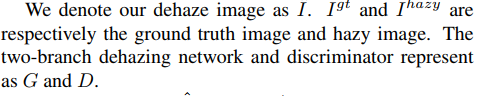

#TEST

In [ ]:
test_dir = '/content/drive/MyDrive/DW  GAN/val2021/hazy/'
test_batch_size = 1
output_dir = '/content/drive/MyDrive/DW  GAN/val2021/result'
test_dataset = dehaze_test_dataset(test_dir)
test_loader = DataLoader(dataset=test_dataset, batch_size=test_batch_size, shuffle=False, num_workers=0)

device_ids = [Id for Id in range(torch.cuda.device_count())]
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

net = fusion_net()


net = net.to(device)
net = nn.DataParallel(net)
net.load_state_dict(torch.load('/content/drive/MyDrive/DW  GAN/dehaze.pkl'))

with torch.no_grad():
    net.eval()
    start_time = time.time()
    for batch_idx, (hazy_up,hazy_down,name) in enumerate(test_loader):
        try:
          hazy_up = hazy_up.to(device)
          hazy_down = hazy_down.to(device)
          print(hazy_up.size())
          frame_out_up = net(hazy_up)
          frame_out_down = net(hazy_down)
          print(frame_out_up.size())
          print(frame_out_down.size())
          frame_out = (torch.cat([frame_out_up[:, :, 0:600, :].permute(0, 2, 3, 1), frame_out_down[:, :, 552:, :].permute(0, 2, 3, 1)],1)).permute(0, 3, 1, 2)
          print(frame_out.size())
          if not os.path.exists(output_dir + '/'):
              os.makedirs(output_dir + '/')
          name= re.findall("\d+",str(name))
          imwrite(frame_out, output_dir + '/' + str(name[0])+'.png', range=(0, 1))
        except:
          print(name)
test_time = time.time() - start_time
print(test_time)

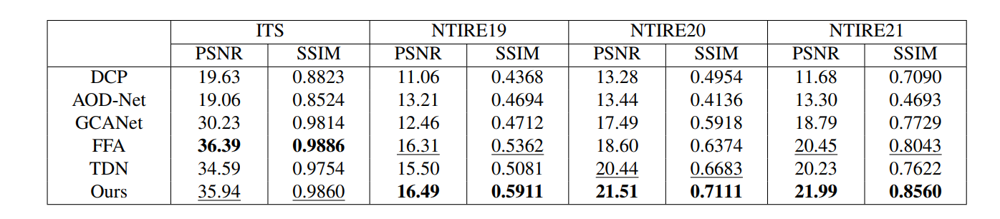